In [61]:
from sklearn.model_selection import train_test_split
from bltk.langtools import Tokenizer # BLTK: The Bengali Natural Language Processing Toolkit
from bltk.langtools import remove_stopwords
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score
from sklearn.metrics import make_scorer, roc_auc_score
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV 
from scipy import stats
import matplotlib.pyplot as plt
import sklearn.metrics as metrics

import collections
import nltk
import numpy as np
import pandas as pd
import codecs

In [62]:
from bltk.langtools.banglachars import (vowels,
                                        vowel_signs,
                                        consonants,
                                        digits,
                                        operators,
                                        punctuations,
                                        others)


In [63]:
print(f'Vowels: {vowels}')
print(f'Vowel signs: {vowel_signs}')
print(f'Consonants: {consonants}')
print(f'Digits: {digits}')
print(f'Operators: {operators}')
print(f'Punctuation marks: {punctuations}')
print(f'Others: {others}')

Vowels: ['অ', 'আ', 'ই', 'ঈ', 'উ', 'ঊ', 'ঋ', 'ঌ', 'এ', 'ঐ', 'ও', 'ঔ']
Vowel signs: ['া', 'ি', 'ী', 'ু', 'ূ', 'ৃ', 'ৄ', 'ে', 'ৈ', 'ো', 'ৌ']
Consonants: ['ক', 'খ', 'গ', 'ঘ', 'ঙ', 'চ', 'ছ', 'জ', 'ঝ', 'ঞ', 'ট', 'ঠ', 'ড', 'ঢ', 'ণ', 'ত', 'থ', 'দ', 'ধ', 'ন', 'প', 'ফ', 'ব', 'ভ', 'ম', 'য', 'র', 'ল', 'শ', 'ষ', 'স', 'হ', 'ড়', 'ঢ়', 'য়', 'ৎ', 'ং', 'ঃ', 'ঁ']
Digits: ['০', '১', '২', '৩', '৪', '৫', '৬', '৭', '৮', '৯']
Operators: ['=', '+', '-', '*', '/', '%', '<', '>', '×', '÷']
Punctuation marks: ['।', ',', ';', ':', '?', '!', "'", '.', '"', '-', '[', ']', '{', '}', '(', ')', '–', '—', '―', '~']
Others: ['৳', '৺', '্', 'ঀ', 'ঽ', '#', '$']


In [64]:
import csv


INPUT_FILE = 'balanced_dataset.csv'
stopwords_list = 'stopwords.txt'

counter = collections.Counter()
tokenizer = Tokenizer()
maxlen = 0
xs, ys = [], []
bangla_stopwords = codecs.open(stopwords_list, 'r', encoding='utf-8').read().split()

with codecs.open(INPUT_FILE, "r", encoding='utf-8') as fin:
    # Update the delimiter based on your CSV file's format
    csv_reader = csv.reader(fin, delimiter=',')  # Change ',' to your actual delimiter
    next(csv_reader)  # Skip the header row if your CSV has a header
    for line in csv_reader:
        try:
            label, sent = line[3], line[2]
            print("Label: ", label)
            print("Sentence: ", sent)

            words = tokenizer.word_tokenizer(sent)
            print("After Tokenizing: ", words)

            punctuations = ['.', ',', ';', ':', '!', '?', '']
            wordsExcludingPunctuationMarks = [word for word in words if word not in punctuations]
            print("Truncating punctuation:", wordsExcludingPunctuationMarks)
            
            wordsExcludingStopWords = [word.strip() for word in wordsExcludingPunctuationMarks if word not in bangla_stopwords]
            print("Truncating StopWords:", wordsExcludingStopWords)

            ys.append(int(label))
            xs.append(' '.join(wordsExcludingStopWords))
        except IndexError:
            print("Error processing line:", line)


Label:  2
Sentence:  Sob tik ase vai...
But 30 min a j kotha ti bollen j 1000tk r product 2000tk..ata to manus thokano...
After Tokenizing:  ['Sob', 'tik', 'ase', 'vai..', '.', 'But', '30', 'min', 'a', 'j', 'kotha', 'ti', 'bollen', 'j', '1000tk', 'r', 'product', '2000tk..ata', 'to', 'manus', 'thokano..', '.']
Truncating punctuation: ['Sob', 'tik', 'ase', 'vai..', 'But', '30', 'min', 'a', 'j', 'kotha', 'ti', 'bollen', 'j', '1000tk', 'r', 'product', '2000tk..ata', 'to', 'manus', 'thokano..']
Truncating StopWords: ['Sob', 'tik', 'ase', 'vai..', 'But', '30', 'min', 'a', 'j', 'kotha', 'ti', 'bollen', 'j', '1000tk', 'r', 'product', '2000tk..ata', 'to', 'manus', 'thokano..']
Label:  2
Sentence:  sahos pelam vai
After Tokenizing:  ['sahos', 'pelam', 'vai']
Truncating punctuation: ['sahos', 'pelam', 'vai']
Truncating StopWords: ['sahos', 'pelam', 'vai']
Label:  2
Sentence:  “দুনিয়াতে এমন ভাবে জীবন যাপন করো যেনো তুমি একজন গরীব কিংবা পথিক।” [সহীহ বুখারী]
– হযরত মুহাম্মদ (সাঃ)
After Tokenizing:  [

In [65]:
xs

['Sob tik ase vai.. But 30 min a j kotha ti bollen j 1000tk r product 2000tk..ata to manus thokano..',
 'sahos pelam vai',
 '“দুনিয়াতে জীবন যাপন করো যেনো একজন গরীব পথিক।” সহীহ [ বুখারী ] – হযরত মুহাম্মদ (সাঃ )',
 'আলহামদুলিল্লাহ 127 পরিবার আলহামদুলিল্লাহ আপনাদের ভালোবাসা ইনশাআল্লাহ সফল হব',
 'ক্লাস ১২ ১৮ বয়সের একজন,,,,জানিনা কারণে আজকে সাজ্জাদ ভাই,আর সীমান্ত ভাইয়ের কথা মনের ভিতর শীতল দিয়েছে রাত ১:৪৬ ঘুম নাই বরংচ যতই শুনতেছি,ততই মুগ্ধ হচ্ছি️আর আলহামদুলিল্লাহ toxic রিলেশন বের পারছি,️',
 'go ahead brother,its gonna viral and you really deserve it',
 'যতগুলা কথাবার্তা হয়েছে এখান ৫০ লাখ বিক্রি সম্ভব । -ফাবরবাজ ।',
 'আলহামদুলিল্লাহ 127 পরিবার আলহামদুলিল্লাহ আপনাদের ভালোবাসা ইনশাআল্লাহ সফল হব',
 'proffesor mir bhai keep cooming',
 'প্রবল জেদ+সাহস ফারদি ভাই উজ্জ্বল দৃষ্টান্ত ..',
 "Privacy is power What people don't know they can't ruin Never trust anybody Be alone & stoic",
 'Masallah',
 'সাধারণত ভিডিও টেনে টেনে দেখি.. স্কিপ না ফুল ভিডিও দেখলাম.. সেরা একটা পডকাস্ট ️',
 'প্রিয় পডকাস্টে প্রিয় ম

###TF IDF

In [66]:
Xtrain, Xtest, Ytrain, Ytest = train_test_split(xs, ys, test_size=0.25, random_state=0)
Xtrain

['Joss',
 'ফ্রিল্যান্সিং সেক্টরে গাইডলাইন প্রয়োজন',
 'Best Podcast...অনেক শেখার',
 'Sound quality kharap... We hope it will be better at next vedio',
 'requested to do a podcast with Fahmid Bhai',
 'thank you so much vaiya',
 'Numeri Sattar Apar ভাইকে চায়',
 "things I learnt in a new fashion -> you can start with zero capital creating ( content funneling people who want to read it to an ebook ) -> storytelling capturing ATTENTION and giving them a call to action -> it is not only me it's me & you vs the problem in a partnership",
 'ময়মনসিংহের গর্ব️',
 'what,s the name of book seller',
 'নাফিস ভাই দক্ষিণ এশিয়ার সেরা উদ্যোক্তা পুরস্কার প্রাপ্ত বাংলাদেশের জনপ্রিয় অ্যাপস ডেভেলপার মো জোবায়ের হোসেন ভাই আপনাদের পোগ্রামে চাই প্লিজ প্লিজ প্লিজ',
 'কোর্স বিক্রি বড়লোক । দোকাবাজের সবায় সাবধান । বাঙ্গালি ইমোশনাল ধোকাবাজের কোর্স কিনে ।',
 '52:56 বই টার নাম',
 'S.A Corporation S.A Corporation আপনারা পাচ্ছেন কসমেটিকস স্কিন কেয়ার প্রোডাক্ট ফ্যাশন আইটেমস পাশাপাশি ঘর সাজানোর দারুণ হোম ডেকর প্রয়োজনীয় স

In [115]:
def custom_tokenizer(text):
    return text.split()
tfidf = TfidfVectorizer(ngram_range=(1,3),use_idf=True,tokenizer=custom_tokenizer) 
Xtrain_tf = tfidf.fit_transform(Xtrain)
print("n_samples: %d, n_features: %d" % Xtrain_tf.shape)

# Assuming `vectorizer` is your TF-IDF vectorizer that you've fitted on your training data

# Save the vectorizer to a file
# joblib.dump(tfidf, 'tfidf.joblib')

/Users/sirajussalekin/Desktop/nlp-text-classification/myenv/lib/python3.9/site-packages/sklearn/feature_extraction/text.py:525: UserWarning: The parameter 'token_pattern' will not be used since 'tokenizer' is not None'
  warnings.warn(


n_samples: 15097, n_features: 34211


In [116]:
#transforming test data into tf-idf matrix
Xtest_tf = tfidf.transform(Xtest)
print("n_samples: %d, n_features: %d" % Xtest_tf.shape)

n_samples: 5033, n_features: 34211


In [118]:
import pickle
# Save the vectorizer to a file using pickle
with open('tfidf.pickle', 'wb') as file:
    pickle.dump(tfidf, file)

###Naive Bayes

In [69]:
#naive bayes classifier
from sklearn.naive_bayes import MultinomialNB
naive_bayes_classifier = MultinomialNB()
naive_bayes_classifier.fit(Xtrain_tf, Ytrain)
#predicted y
y_pred = naive_bayes_classifier.predict(Xtest_tf)

[[1672    0    0]
 [   0 1680    2]
 [  67   31 1581]]
0.9801311345122193
              precision    recall  f1-score   support

           0       0.96      1.00      0.98      1672
           1       0.98      1.00      0.99      1682
           2       1.00      0.94      0.97      1679

    accuracy                           0.98      5033
   macro avg       0.98      0.98      0.98      5033
weighted avg       0.98      0.98      0.98      5033



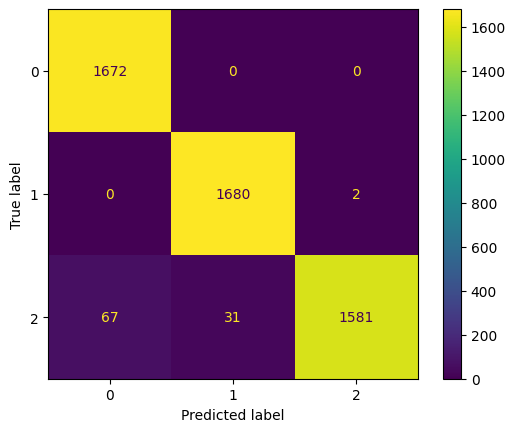

In [70]:
print(confusion_matrix(Ytest,y_pred))
print(accuracy_score(Ytest,y_pred))
print(classification_report(Ytest,y_pred))

cm = confusion_matrix(Ytest, y_pred, labels=naive_bayes_classifier.classes_)
disp = ConfusionMatrixDisplay(confusion_matrix=cm,
                              display_labels=naive_bayes_classifier.classes_)
disp.plot()
plt.show()

###Logistic Regression

In [71]:
from sklearn.linear_model import LogisticRegression
LRClassification=LogisticRegression()
LRClassification.fit(Xtrain_tf, Ytrain)
y_pred=LRClassification.predict(Xtest_tf)

[[1672    0    0]
 [   0 1679    3]
 [   0   11 1668]]
0.9972183588317107
              precision    recall  f1-score   support

           0       1.00      1.00      1.00      1672
           1       0.99      1.00      1.00      1682
           2       1.00      0.99      1.00      1679

    accuracy                           1.00      5033
   macro avg       1.00      1.00      1.00      5033
weighted avg       1.00      1.00      1.00      5033



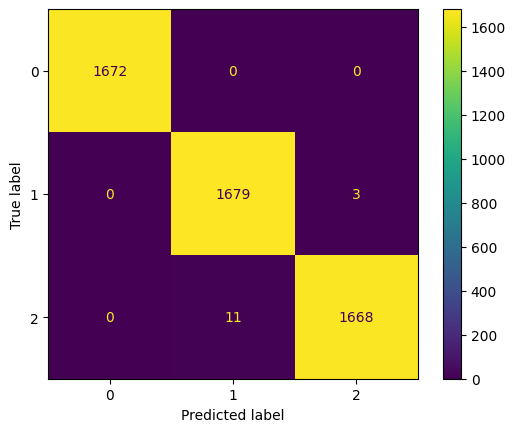

In [72]:
print(confusion_matrix(Ytest,y_pred))
print(accuracy_score(Ytest,y_pred))
print(classification_report(Ytest,y_pred))

cm = confusion_matrix(Ytest, y_pred, labels=LRClassification.classes_)
disp = ConfusionMatrixDisplay(confusion_matrix=cm,
                              display_labels=LRClassification.classes_)
disp.plot()
plt.show()

###Decision Tree

In [73]:
from sklearn.tree import DecisionTreeClassifier
DTClassification=DecisionTreeClassifier(criterion = 'entropy', random_state = 0)
DTClassification.fit(Xtrain_tf, Ytrain)
y_pred=DTClassification.predict(Xtest_tf)

[[1672    0    0]
 [   0 1682    0]
 [   0    1 1678]]
0.9998013113451222
              precision    recall  f1-score   support

           0       1.00      1.00      1.00      1672
           1       1.00      1.00      1.00      1682
           2       1.00      1.00      1.00      1679

    accuracy                           1.00      5033
   macro avg       1.00      1.00      1.00      5033
weighted avg       1.00      1.00      1.00      5033



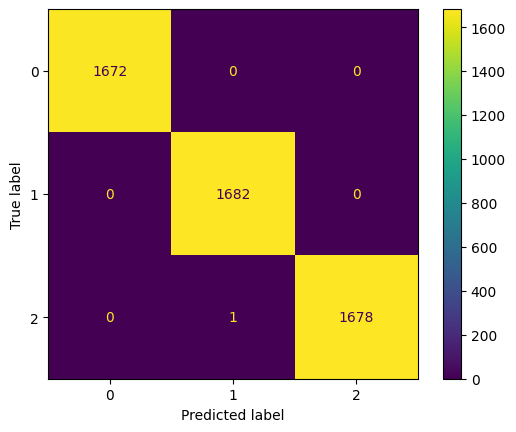

In [74]:
print(confusion_matrix(Ytest,y_pred))
print(accuracy_score(Ytest,y_pred))
print(classification_report(Ytest,y_pred))

cm = confusion_matrix(Ytest, y_pred, labels=DTClassification.classes_)
disp = ConfusionMatrixDisplay(confusion_matrix=cm,
                              display_labels=DTClassification.classes_)
disp.plot()
plt.show()

###SVM

In [75]:
from sklearn import svm
clf = svm.SVC(kernel='linear') # Linear Kernel
#Train the model using the training sets
clf.fit(Xtrain_tf, Ytrain)
#Predict the response for test dataset
y_pred = clf.predict(Xtest_tf)

[[1672    0    0]
 [   0 1680    2]
 [   0   15 1664]]
0.9966222928670773
              precision    recall  f1-score   support

           0       1.00      1.00      1.00      1672
           1       0.99      1.00      0.99      1682
           2       1.00      0.99      0.99      1679

    accuracy                           1.00      5033
   macro avg       1.00      1.00      1.00      5033
weighted avg       1.00      1.00      1.00      5033



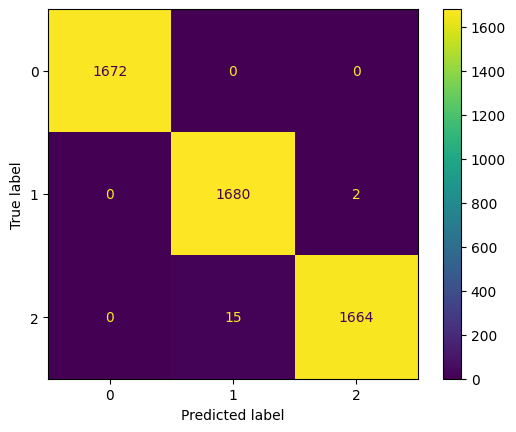

In [76]:
print(confusion_matrix(Ytest,y_pred))
print(accuracy_score(Ytest,y_pred))
print(classification_report(Ytest,y_pred))

cm = confusion_matrix(Ytest, y_pred, labels=clf.classes_)
disp = ConfusionMatrixDisplay(confusion_matrix=cm,
                              display_labels=clf.classes_)
disp.plot()
plt.show()

###Random Forest

In [77]:
from sklearn.ensemble import RandomForestClassifier
rf_classifier=RandomForestClassifier(n_estimators=100, criterion ='entropy', random_state = 0).fit(Xtrain_tf, Ytrain)
y_pred=rf_classifier.predict(Xtest_tf)

[[1672    0    0]
 [   0 1681    1]
 [   0    3 1676]]
0.9992052453804888
              precision    recall  f1-score   support

           0       1.00      1.00      1.00      1672
           1       1.00      1.00      1.00      1682
           2       1.00      1.00      1.00      1679

    accuracy                           1.00      5033
   macro avg       1.00      1.00      1.00      5033
weighted avg       1.00      1.00      1.00      5033



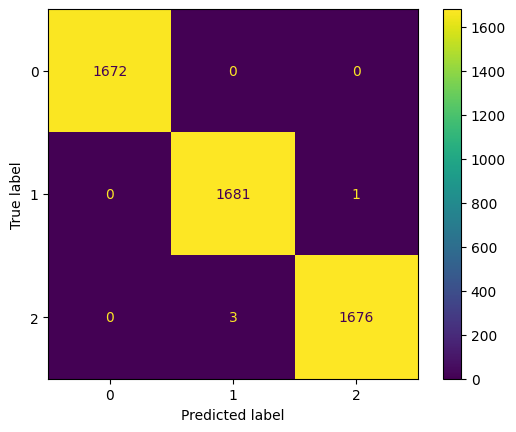

In [78]:
print(confusion_matrix(Ytest,y_pred))
print(accuracy_score(Ytest,y_pred))
print(classification_report(Ytest,y_pred))

cm = confusion_matrix(Ytest, y_pred, labels=rf_classifier.classes_)
disp = ConfusionMatrixDisplay(confusion_matrix=cm,
                              display_labels=rf_classifier.classes_)
disp.plot()
plt.show()

###SGD

In [79]:
from sklearn.linear_model import SGDClassifier
sgd_classifier = SGDClassifier(loss = 'squared_error',penalty='l2', max_iter=10,random_state=0).fit(Xtrain_tf, Ytrain)
y_pred=sgd_classifier.predict(Xtest_tf)

/Users/sirajussalekin/Desktop/nlp-text-classification/myenv/lib/python3.9/site-packages/sklearn/linear_model/_stochastic_gradient.py:723: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(


[[   0  358 1314]
 [ 298  589  795]
 [ 293  644  742]]
0.2644545996423604
              precision    recall  f1-score   support

           0       0.00      0.00      0.00      1672
           1       0.37      0.35      0.36      1682
           2       0.26      0.44      0.33      1679

    accuracy                           0.26      5033
   macro avg       0.21      0.26      0.23      5033
weighted avg       0.21      0.26      0.23      5033



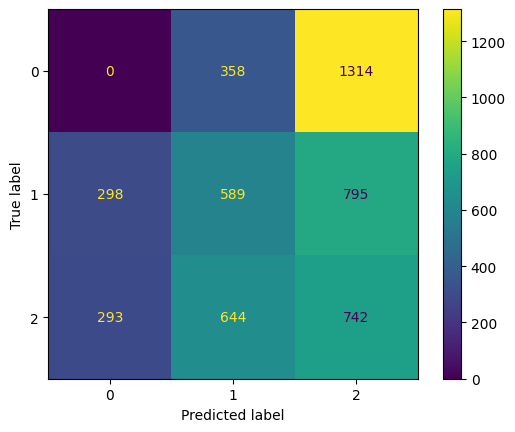

In [80]:
print(confusion_matrix(Ytest,y_pred))
print(accuracy_score(Ytest,y_pred))
print(classification_report(Ytest,y_pred))

cm = confusion_matrix(Ytest, y_pred, labels=sgd_classifier.classes_)
disp = ConfusionMatrixDisplay(confusion_matrix=cm,
                              display_labels=sgd_classifier.classes_)
disp.plot()
plt.show()

###Randomized Search CV

In [81]:
# svm_clf = svm.SVC(probability = True, random_state = 1)
# auc = make_scorer(roc_auc_score)
 
# # RANDOM SEARCH FOR 20 COMBINATIONS OF PARAMETERS
# rand_list = {"C": stats.uniform(2, 10),
#              "gamma": stats.uniform(0.1, 1),
#              'kernel': ['rbf']}
              
# rand_search = RandomizedSearchCV(svm_clf , param_distributions = rand_list, n_iter = 20, n_jobs = 4, cv = 3, random_state = 2017, scoring = auc) 
# rand_search.fit(Xtrain_tf, Ytrain) 
# rand_search.cv_results_
# rand_predictions = rand_search.predict(Xtest_tf)
  

In [82]:
# print(confusion_matrix(Ytest,y_pred))
# print(accuracy_score(Ytest,y_pred))
# print(classification_report(Ytest,y_pred))

# cm = confusion_matrix(Ytest, y_pred, labels=rand_search.classes_)
# disp = ConfusionMatrixDisplay(confusion_matrix=cm,
#                               display_labels=rand_search.classes_)
# disp.plot()
# plt.show()

###XGBoost

Class mapping: {0: 0, 1: 1, 2: 2}
[[1672    0    0]
 [   0 1682    0]
 [   0    0 1679]]
1.0
              precision    recall  f1-score   support

           0       1.00      1.00      1.00      1672
           1       1.00      1.00      1.00      1682
           2       1.00      1.00      1.00      1679

    accuracy                           1.00      5033
   macro avg       1.00      1.00      1.00      5033
weighted avg       1.00      1.00      1.00      5033



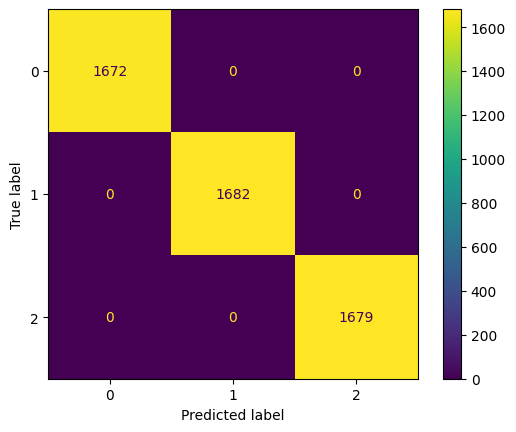

In [83]:
from xgboost import XGBClassifier

from sklearn.preprocessing import LabelEncoder

# Assuming Xtrain_tf, Ytrain, Xtest_tf, Ytest are already defined

# Use LabelEncoder to convert class labels to start from 0
label_encoder = LabelEncoder()
Ytrain_encoded = label_encoder.fit_transform(Ytrain)

# Mapping of original class labels to encoded class labels
class_mapping = dict(zip(label_encoder.classes_, range(len(label_encoder.classes_))))
print("Class mapping:", class_mapping)

# Create and train XGBoost classifier
xgb_classifier = XGBClassifier(objective='multi:softmax', num_class=3, n_estimators=100, random_state=0)
xgb_classifier.fit(Xtrain_tf, Ytrain_encoded)

# Make predictions
y_pred_xgb_encoded = xgb_classifier.predict(Xtest_tf)

# Convert back to original class labels for evaluation
y_pred_xgb = label_encoder.inverse_transform(y_pred_xgb_encoded)

# Print evaluation metrics
print(confusion_matrix(Ytest, y_pred_xgb))
print(accuracy_score(Ytest, y_pred_xgb))
print(classification_report(Ytest, y_pred_xgb))

# Plot confusion matrix
cm_xgb = confusion_matrix(Ytest, y_pred_xgb, labels=xgb_classifier.classes_)
disp_xgb = ConfusionMatrixDisplay(confusion_matrix=cm_xgb,
                                  display_labels=xgb_classifier.classes_)
disp_xgb.plot()
plt.show()


In [84]:
#pip install joblib

In [85]:
from joblib import dump

# Save the model to a file
dump(xgb_classifier, "xgb_classifier.pkl")

['xgb_classifier.pkl']

In [86]:
from joblib import load

# Load model from file
loaded_model = load("xgb_classifier.pkl")

In [87]:
sentence = "Ami janina kivabe eita hoy"
sentence_list = []
try:
    words = tokenizer.word_tokenizer(sentence)
    print("After Tokenizing: ", words)

    punctuations = ['.', ',', ';', ':', '!', '?', '']
    wordsExcludingPunctuationMarks = [word for word in words if word not in punctuations]
    print("Truncating punctuation:", wordsExcludingPunctuationMarks)
    
    wordsExcludingStopWords = [word.strip() for word in wordsExcludingPunctuationMarks if word not in bangla_stopwords]
    print("Truncating StopWords:", wordsExcludingStopWords)

    sentence_list.append(' '.join(wordsExcludingStopWords))
except IndexError:
    print("Error processing line:", line)

print(sentence_list)    

After Tokenizing:  ['Ami', 'janina', 'kivabe', 'eita', 'hoy']
Truncating punctuation: ['Ami', 'janina', 'kivabe', 'eita', 'hoy']
Truncating StopWords: ['Ami', 'janina', 'kivabe', 'eita', 'hoy']
['Ami janina kivabe eita hoy']


In [88]:
sentence_list_tf = tfidf.transform(sentence_list)
print("n_samples: %d, n_features: %d" % sentence_list_tf.shape)

n_samples: 1, n_features: 34211


In [111]:
y_pred_xgb_encoded = loaded_model.predict(sentence_list_tf)

# Convert back to original class labels for evaluation
y_pred_xgb = label_encoder.inverse_transform(y_pred_xgb_encoded)

print(y_pred_xgb)

if(y_pred_xgb[0] == 0):
    print("Negative Sentiment")

elif (y_pred_xgb[0] == 1):
    print("positive Sentiment")

else:
    print("Neutral Sentiment")    

[2]
Neutral Sentiment


In [119]:

from bltk.langtools import Tokenizer # BLTK: The Bengali Natural Language Processing Toolkit
from bltk.langtools import remove_stopwords
import nltk
from bltk.langtools.banglachars import (vowels,
                                        vowel_signs,
                                        consonants,
                                        digits,
                                        operators,
                                        punctuations,
                                        others)
tokenizer = Tokenizer()

import codecs

from joblib import load
import pickle

# Load the vectorizer back from the file
with open('tfidf.pickle', 'rb') as file:
    loaded_vectorizer = pickle.load(file)

# Load model from file
loaded_model = load("xgb_classifier.pkl")

while True:
    print("Type 'quit' to exit")

    sentence = input("You: ")
    if sentence == 'quit':
        break

    sentence_list = []
    try:
        words = tokenizer.word_tokenizer(sentence)
        print("After Tokenizing: ", words)

        punctuations = ['.', ',', ';', ':', '!', '?', '']
        wordsExcludingPunctuationMarks = [word for word in words if word not in punctuations]
        print("Truncating punctuation:", wordsExcludingPunctuationMarks)
        
        wordsExcludingStopWords = [word.strip() for word in wordsExcludingPunctuationMarks if word not in bangla_stopwords]
        print("Truncating StopWords:", wordsExcludingStopWords)

        sentence_list.append(' '.join(wordsExcludingStopWords))
    except IndexError:
        print("Error processing line:", line)
 
    sentence_list_tf = loaded_vectorizer.transform(sentence_list)
    print("n_samples: %d, n_features: %d" % sentence_list_tf.shape)

    y_pred_xgb_encoded = loaded_model.predict(sentence_list_tf)

    # Convert back to original class labels for evaluation
    y_pred_xgb = label_encoder.inverse_transform(y_pred_xgb_encoded)

    print(y_pred_xgb)

    if(y_pred_xgb[0] == 0):
        print("Negative Sentiment is detected")

    elif (y_pred_xgb[0] == 1):
        print("positive Sentiment is detected")

    elif (y_pred_xgb[0] == 2):
        print("Neutral Sentiment is detected") 

    else: 
        print("Could not detect sentiment")       

Type 'quit' to exit
After Tokenizing:  ['apni', 'bhalo']
Truncating punctuation: ['apni', 'bhalo']
Truncating StopWords: ['apni', 'bhalo']
n_samples: 1, n_features: 34211
[2]
Neutral Sentiment is detected
Type 'quit' to exit
After Tokenizing:  ['apni', 'bhalo']
Truncating punctuation: ['apni', 'bhalo']
Truncating StopWords: ['apni', 'bhalo']
n_samples: 1, n_features: 34211
[2]
Neutral Sentiment is detected
Type 'quit' to exit
After Tokenizing:  ['Apni', 'bhalo', 'korben', 'samne']
Truncating punctuation: ['Apni', 'bhalo', 'korben', 'samne']
Truncating StopWords: ['Apni', 'bhalo', 'korben', 'samne']
n_samples: 1, n_features: 34211
[2]
Neutral Sentiment is detected
Type 'quit' to exit
After Tokenizing:  ['dfbfdbdfd']
Truncating punctuation: ['dfbfdbdfd']
Truncating StopWords: ['dfbfdbdfd']
n_samples: 1, n_features: 34211
[2]
Neutral Sentiment is detected
Type 'quit' to exit
After Tokenizing:  ['Best', 'Podcast..', '.', 'Best', 'of', 'luck', 'vaiya']
Truncating punctuation: ['Best', 'Podc

###AdaBoost

/Users/sirajussalekin/Desktop/nlp-text-classification/myenv/lib/python3.9/site-packages/sklearn/ensemble/_weight_boosting.py:519: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(


[[1462  210    0]
 [   0  522 1160]
 [   0  301 1378]]
0.6679912576991853
              precision    recall  f1-score   support

           0       1.00      0.87      0.93      1672
           1       0.51      0.31      0.38      1682
           2       0.54      0.82      0.65      1679

    accuracy                           0.67      5033
   macro avg       0.68      0.67      0.66      5033
weighted avg       0.68      0.67      0.66      5033



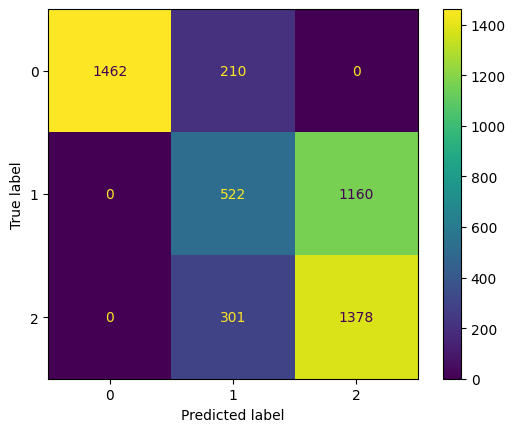

In [90]:
from sklearn.ensemble import AdaBoostClassifier

# Assuming Xtrain_tf, Ytrain, Xtest_tf, Ytest are already defined

# Create and train AdaBoost classifier
adaboost_classifier = AdaBoostClassifier(n_estimators=100, random_state=0)
adaboost_classifier.fit(Xtrain_tf, Ytrain)

# Make predictions
y_pred_adaboost = adaboost_classifier.predict(Xtest_tf)

# Print evaluation metrics
print(confusion_matrix(Ytest, y_pred_adaboost))
print(accuracy_score(Ytest, y_pred_adaboost))
print(classification_report(Ytest, y_pred_adaboost))

# Plot confusion matrix
cm_adaboost = confusion_matrix(Ytest, y_pred_adaboost, labels=adaboost_classifier.classes_)
disp_adaboost = ConfusionMatrixDisplay(confusion_matrix=cm_adaboost,
                                       display_labels=adaboost_classifier.classes_)
disp_adaboost.plot()
plt.show()


###GBM

[[1672    0    0]
 [   0 1655   27]
 [   0    0 1679]]
0.9946354063182993
              precision    recall  f1-score   support

           0       1.00      1.00      1.00      1672
           1       1.00      0.98      0.99      1682
           2       0.98      1.00      0.99      1679

    accuracy                           0.99      5033
   macro avg       0.99      0.99      0.99      5033
weighted avg       0.99      0.99      0.99      5033



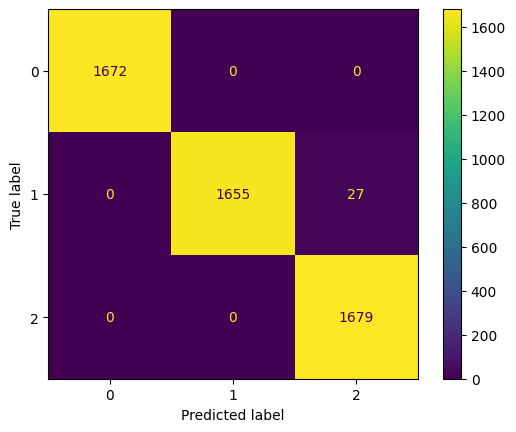

In [91]:
# from sklearn.ensemble import GradientBoostingClassifier
# from sklearn.metrics import confusion_matrix, accuracy_score, classification_report, ConfusionMatrixDisplay
# import matplotlib.pyplot as plt

# # Assuming Xtrain_tf, Ytrain, Xtest_tf, Ytest are already defined

# # Create and train Gradient Boosting classifier
# gbm_classifier = GradientBoostingClassifier(n_estimators=100, random_state=0)
# gbm_classifier.fit(Xtrain_tf, Ytrain)

# # Make predictions
# y_pred_gbm = gbm_classifier.predict(Xtest_tf)

# # Print evaluation metrics
# print(confusion_matrix(Ytest, y_pred_gbm))
# print(accuracy_score(Ytest, y_pred_gbm))
# print(classification_report(Ytest, y_pred_gbm))

# # Plot confusion matrix
# cm_gbm = confusion_matrix(Ytest, y_pred_gbm, labels=gbm_classifier.classes_)
# disp_gbm = ConfusionMatrixDisplay(confusion_matrix=cm_gbm,
#                                   display_labels=gbm_classifier.classes_)
# disp_gbm.plot()
# plt.show()


### Some Preprocess Before Using Any Vectorization Like Word2Vec or Glove

In [92]:
# xs_2, ys_2 = [], []

# with codecs.open(INPUT_FILE, "r", encoding='utf-8') as fin:
#     # Update the delimiter based on your CSV file's format
#     csv_reader = csv.reader(fin, delimiter=',')  # Change ',' to your actual delimiter
#     next(csv_reader)  # Skip the header row if your CSV has a header
#     for line in csv_reader:
#         try:
#             label, sent = line[3], line[2]
#             print("Label: ", label)
#             print("Sentence: ", sent)

#             words = tokenizer.word_tokenizer(sent)
#             print("After Tokenizing: ", words)

#             punctuations = ['.', ',', ';', ':', '!', '?', '']
#             wordsExcludingPunctuationMarks = [word for word in words if word not in punctuations]
#             print("Truncating punctuation:", wordsExcludingPunctuationMarks)
            
#             wordsExcludingStopWords = [word.strip() for word in wordsExcludingPunctuationMarks if word not in bangla_stopwords]
#             print("Truncating StopWords:", wordsExcludingStopWords)

#             ys_2.append(int(label))
#             xs_2.append(wordsExcludingStopWords)
#         except IndexError:
#             print("Error processing line:", line)

In [93]:
# print(xs_2)

In [94]:
# print(ys_2)

### Word2Vector Part

In [95]:
#pip install gensim

In [96]:
# df = pd.DataFrame(xs, columns=['text'])

In [97]:
# df

In [98]:
# from gensim.utils import simple_preprocess
# from gensim.models import Word2Vec

# # Preprocess Text
# #response_new=df.text.apply(simple_preprocess) #issue with preprocess, avoid it


In [99]:
# response_new_series = pd.Series(xs_2)  

In [100]:
# response_new_series

In [101]:
#response_new

In [102]:
# # Train a Word2Vec model
# word2vec_model = Word2Vec(response_new_series, vector_size=100, window=5, min_count=1, workers=4)

# # Define a function to create document vectors
# def document_vector(model, doc):
#     # Remove out-of-vocabulary words and compute the mean
#     return np.mean([model.wv[word] for word in doc if word in model.wv], axis=0)

# # Vectorize your text data
# X = np.array([document_vector(word2vec_model, df['text']) for text in df['text'].values])


In [103]:
# # Define your target variable
# y = ys

In [104]:
# # Split data into training and test sets
# X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)

### Logistic Regression

In [105]:
# # Train a Logistic Regression model
# log_reg_model = LogisticRegression()
# log_reg_model.fit(X_train, y_train)

# # Make predictions and evaluate the model
# predictions = log_reg_model.predict(X_test)
# print("Accuracy:", accuracy_score(y_test, predictions))
# print("\nClassification Report:\n", classification_report(y_test, predictions))

# # Generate and display the confusion matrix
# conf_matrix = confusion_matrix(y_test, predictions)
# disp = ConfusionMatrixDisplay(confusion_matrix=conf_matrix)
# disp.plot(cmap=plt.cm.Blues)
# plt.title('Confusion Matrix')
# plt.show()


### Decision Tree

In [106]:
# from sklearn.tree import DecisionTreeClassifier

# # Train a Decision Tree model
# decision_tree_model = DecisionTreeClassifier()
# decision_tree_model.fit(X_train, y_train)

# # Make predictions and evaluate the model
# predictions = decision_tree_model.predict(X_test)
# print("Accuracy:", accuracy_score(y_test, predictions))
# print("\nClassification Report:\n", classification_report(y_test, predictions))

# # Generate and display the confusion matrix
# conf_matrix = confusion_matrix(y_test, predictions)
# disp = ConfusionMatrixDisplay(confusion_matrix=conf_matrix)
# disp.plot(cmap=plt.cm.Blues)
# plt.title('Confusion Matrix')
# plt.show()


### Random Forest

In [107]:
# from sklearn.ensemble import RandomForestClassifier

# # Train a Random Forest model
# random_forest_model = RandomForestClassifier(n_estimators=100, random_state=42)
# random_forest_model.fit(X_train, y_train)

# # Make predictions and evaluate the model
# predictions = random_forest_model.predict(X_test)
# print("Accuracy:", accuracy_score(y_test, predictions))
# print("\nClassification Report:\n", classification_report(y_test, predictions))

# # Generate and display the confusion matrix
# conf_matrix = confusion_matrix(y_test, predictions)
# disp = ConfusionMatrixDisplay(confusion_matrix=conf_matrix)
# disp.plot(cmap=plt.cm.Blues)
# plt.title('Confusion Matrix')
# plt.show()


### Gradient Boosting

In [108]:
# from sklearn.ensemble import GradientBoostingClassifier

# # Train a Gradient Boosting model
# gradient_boost_model = GradientBoostingClassifier(n_estimators=100, learning_rate=0.1, max_depth=3, random_state=42)
# gradient_boost_model.fit(X_train, y_train)

# # Make predictions and evaluate the model
# predictions = gradient_boost_model.predict(X_test)
# print("Accuracy:", accuracy_score(y_test, predictions))
# print("\nClassification Report:\n", classification_report(y_test, predictions))

# # Generate and display the confusion matrix
# conf_matrix = confusion_matrix(y_test, predictions)
# disp = ConfusionMatrixDisplay(confusion_matrix=conf_matrix)
# disp.plot(cmap=plt.cm.Blues)
# plt.title('Confusion Matrix')
# plt.show()


In [109]:
# from xgboost import XGBClassifier

# # Train an XGBoost model
# xgb_model = XGBClassifier(n_estimators=100, learning_rate=0.1, max_depth=3, use_label_encoder=False, eval_metric='logloss', random_state=42)
# xgb_model.fit(X_train, y_train)

# # Make predictions and evaluate the model
# predictions = xgb_model.predict(X_test)
# print("Accuracy:", accuracy_score(y_test, predictions))
# print("\nClassification Report:\n", classification_report(y_test, predictions))

# # Generate and display the confusion matrix
# conf_matrix = confusion_matrix(y_test, predictions)
# disp = ConfusionMatrixDisplay(confusion_matrix=conf_matrix)
# disp.plot(cmap=plt.cm.Blues)
# plt.title('Confusion Matrix')
# plt.show()

### Glove (Computation Intensive)

In [110]:
# # Just a boiler plate to use GLoVE
# # just run if you have enough computational power
# # Load GloVe Embeddings
# """def load_glove_embeddings(path):
#     with open(path, 'r', encoding='utf-8') as f:
#         embeddings = {}
#         for line in f:
#             values = line.split()
#             word = values[0]
#             vector = np.asarray(values[1:], dtype='float32')
#             embeddings[word] = vector
#         return embeddings

# glove_embeddings = load_glove_embeddings('glove.6B.50d.txt') # Replace with GloVe file path

# # Vectorize Text Data
# def vectorize_text(text, embeddings):
#     words = tokenizer.word_tokenizer(text) #nltk.word_tokenize(text)
#     word_vectors = [embeddings.get(w, np.zeros((50,))) for w in words]
#     return np.mean(word_vectors, axis=0)

# df['vector'] = df['text'].apply(lambda x: vectorize_text(x, glove_embeddings))

# # Machine Learning Model
# X = np.array(df['vector'].tolist())
# y = ys

# X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# model = LogisticRegression()
# model.fit(X_train, y_train)

# # Model Evaluation
# y_pred = model.predict(X_test)
# accuracy = accuracy_score(y_test, y_pred)
# print(f'Model Accuracy: {accuracy}')"""